In [1]:
%load_ext autoreload
%matplotlib inline

In [2]:
import matplotlib as plt

In [3]:
import os, sys
# sys.path.append(os.getcwd())

import time

from utility import mkdir_p, generate_image
from plot import plot, flush

import numpy as np


import torch
import torchvision
import torchvision.datasets as dset
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch import nn
from torch import autograd
from torch import optim
import argparse
import csv

In [4]:
import matplotlib.pyplot as plt

In [5]:
name='CatGan_Monkey_i256_b128_e500_st'
results_dir='results'
resize=256
image_size=256#256
batch_size=128
workers=0
noise_dim=100
dim= 8
data_dir='data/Kaggle_Monkey'
num_epochs=500
checkpoints_dir='checkpoints'
continue_train= False
# parser = argparse.ArgumentParser(description='parse the input options')

# parser.add_argument('--name', type=str, default='cifar10', help='name of the experiment. It decides where to store the results and checkpoints')
# parser.add_argument('--results_dir', type=str, default='./results', help='folder to store the results')
# parser.add_argument('--image_size', type=int, default=32, help='input image size, for cifar10 is 32x32')
# parser.add_argument('--batch_size', type=int, default=20, help='batch size')
# parser.add_argument('--workers', type=int, default=2, help='# of workers to load the dataset')
# parser.add_argument('--checkpoints_dir', type=str, default='./checkpoints', help='folder to store the model checkpoint')
# parser.add_argument('--noise_dim', type=int, default=100, help='input dim of noise')
# parser.add_argument('--dim', type=int, default=64, help='# of filters in first conv layer of both discrim and gen')
# parser.add_argument('--data_dir', required=True, help='folder of the dataset')
# parser.add_argument('--netG', type=str, default='', help='checkpoints of netG you wish to use in continuing the training')
# parser.add_argument('--netD', type=str, default='', help='checkpoints of netD you wish to use in continuing the training')
# parser.add_argument('--continue_train', action='store_true', help='continue training: load the latest model')
# parser.add_argument('--num_epochs', type=int, default=200, help='# of epochs to train')

In [6]:
dtype = torch.FloatTensor

In [7]:
mkdir_p(os.path.join(results_dir,name))
mkdir_p(os.path.join(checkpoints_dir,name))

In [8]:
#using torchvision ImageFolder for importing this dataset
transform = {
    'train': transforms.Compose([
        transforms.Resize(resize),
        transforms.CenterCrop(image_size),
        transforms.ColorJitter(),
        transforms.ToTensor(),
        transforms.Normalize(mean = [0.39099613,0.39099613,0.39099613], std = [0.1970754,0.1970754,0.1970754])
    ]),
    'val': transforms.Compose([
        transforms.Resize(resize),
        transforms.CenterCrop(image_size),
        transforms.ColorJitter(),
        transforms.ToTensor(),
        transforms.Normalize(mean = [0.39099613,0.39099613,0.39099613], std = [0.1970754,0.1970754,0.1970754])
    ])
}
trainData = torchvision.datasets.ImageFolder(root=data_dir+'/training',transform=transform['train'])
trainDataLoader = DataLoader(trainData,batch_size=batch_size,shuffle=True,num_workers=workers)
valData = torchvision.datasets.ImageFolder(root=data_dir+'/validation',transform=transform['val'])
valDataLoader = DataLoader(valData,batch_size=batch_size,shuffle=True,num_workers=workers)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

torch.Size([128, 3, 256, 256])
torch.Size([128])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

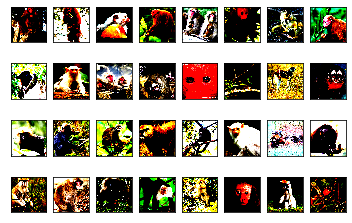

In [9]:
dataiter=iter(trainDataLoader)
images,labels=next(dataiter)
print(images.shape)
print(labels.shape)
fig = plt.figure()
for i in range(32):
    plt.subplot(4,8,i+1)
#     plt.tight_layout()
    plt.imshow(images[i].numpy().transpose((1, 2, 0)))
#     plt.title(labels[i])
    plt.xticks([])
    plt.yticks([])
fig

In [9]:
# trainset = torchvision.datasets.CIFAR10(
#     root='./data', train=True, download=True, transform=transform_train)# Dataset iterator

# dataset = dset.CIFAR10(root='./data', train=True, download=True,
#                            transform=transforms.Compose([
#                                transforms.Scale(image_size),
#                                transforms.ToTensor(),
#                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
#                            ]))


# assert dataset
# dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
#                                          shuffle=True, num_workers=int(workers))

In [10]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
                # input is Z, going into a convolution (1000 * 1 * 1)
                nn.ConvTranspose2d(noise_dim, dim * 32, 4, 1, 0, bias=False),
                nn.BatchNorm2d(dim * 32),
                nn.LeakyReLU(0.2, inplace=True),
                # state size. (dim*32= 256) x 4 x 4
            
                nn.ConvTranspose2d(dim * 32, dim * 16, 4, 2, 1, bias=False),
                nn.BatchNorm2d(dim * 16),
                nn.LeakyReLU(0.2, inplace=True),
                # state size. (dim*16=128) x 8 x 8
            
                nn.ConvTranspose2d(dim * 16, dim * 8, 4, 2, 1, bias=False),
                nn.BatchNorm2d(dim * 8),
                nn.LeakyReLU(0.2, inplace=True),
                # state size. (dim*8=64) x 16 x 16
            
                nn.ConvTranspose2d(dim * 8, dim * 4, 4, 2, 1, bias=False),
                nn.BatchNorm2d(dim * 4),
                nn.LeakyReLU(0.2, inplace=True),
                # state size. (dim*4=32) x 32 x 32
            
                nn.ConvTranspose2d(dim * 4, dim * 2, 4, 2, 1, bias=False),
                nn.BatchNorm2d(dim * 2),
                nn.LeakyReLU(0.2, inplace=True),
                # state size. (dim*2=16) x 64 x 64
            
                nn.ConvTranspose2d(dim * 2, dim, 4, 2, 1, bias=False),
                nn.BatchNorm2d(dim),
                nn.LeakyReLU(0.2, inplace=True),
                # state size. (dim=8) x 128 x 128
                        
                nn.ConvTranspose2d(dim, dim, 4, 2, 1, bias=False),
                nn.BatchNorm2d(dim),
                nn.LeakyReLU(0.2, inplace=True),
                # state size. (dim=8) x 256 x 256
            
                nn.ConvTranspose2d(dim, 3, 1),
                nn.Tanh()
                # state size. (nc) x 256 x 256
            )

    def forward(self, input):
        output = self.main(input)
        return output

In [11]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        main = nn.Sequential(
            nn.Conv2d(3,dim, 4, 2, 1, bias=False),
            nn.BatchNorm2d(dim),
            nn.LeakyReLU(0.2, inplace=True),
             # state size. (dim=8) x 4 x 4
            
            nn.Conv2d(dim,dim*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(dim*2),
            nn.LeakyReLU(0.2, inplace=True),            
            nn.Dropout(0.5),
             # state size. (dim*2= 16) x 8 x 8
            
            nn.Conv2d(dim*2, dim*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(dim*4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.5),#128x8x8
             # state size. (dim*4= 32) x 16 x 16
            
            nn.Conv2d(dim*4, dim*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(dim*8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.5),
             # state size. (dim*8= 64) x 32 x 32
            
            nn.Conv2d(8*dim, 16*dim, 4),
            nn.BatchNorm2d(dim*16),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.5),#256x1x1
             # state size. (dim*16= 128) x 64 x 64
 
            nn.Conv2d(16*dim, 32*dim, 4),
            nn.BatchNorm2d(dim*32),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.5),
             # state size. (dim*16= 128) x 64 x 64

            nn.Conv2d(32*dim, 10, 1)
             # state size. (dim*16= 256) x 10 x 1
        )

        self.main = main
        self.softmax = nn.Softmax()

    def forward(self, input):
        output = self.main(input)
        output = output.view(-1, 10)
        output = self.softmax(output)
        return output


In [12]:

#marginalized entropy
def entropy1(y):
    y1 = autograd.Variable(torch.randn(y.size(1)).type(dtype), requires_grad=True)
    y2 = autograd.Variable(torch.randn(1).type(dtype), requires_grad=True)
    y1 = y.mean(0)
    y2 = -torch.sum(y1*torch.log(y1+1e-6))

    return y2



# entropy
def entropy2(y):
    y1 = autograd.Variable(torch.randn(y.size()).type(dtype), requires_grad=True)
    y2 = autograd.Variable(torch.randn(1).type(dtype), requires_grad=True)
    y1 = -y*torch.log(y+1e-6)

    y2 = 1.0/batch_size*y1.sum()
    return y2

In [13]:
netG = Generator()
netD = Discriminator()

#continue traning by loading the latest model or the model specified in --netG and --netD
if continue_train:
    if netG != '':
        netG.load_state_dict(torch.load(netG))
    else:
        netG.load_state_dict(torch.load('%s/netG_latest.pth' % (os.path.join(checkpoints_dir,name))))


    if netD != '':
        netD.load_state_dict(torch.load(netD))
    else:
        netD.load_state_dict(torch.load('%s/netD_latest.pth' % (os.path.join(checkpoints_dir,name))))



print (netG)
print (netD)

use_cuda = torch.cuda.is_available()

if use_cuda:
    print('Using cuda')
    netD = netD.cuda()
    netG = netG.cuda()

one = torch.tensor(1, dtype=torch.float)# torch.FloatTensor([1])
mone = one * -1

if use_cuda:
    one = one.cuda()
    mone = mone.cuda()

optimizerD = optim.Adam(netD.parameters(), lr=2e-4, betas=(0.5, 0.9))
optimizerG = optim.Adam(netG.parameters(), lr=2e-4, betas=(0.5, 0.9))

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): ConvTranspos

In [14]:
print("Start training on %s dataset which contains %d images..." %(name, len(trainData)))
iter_idx = 0
# with open(os.path.join(results_dir, name, 'log_monkey.csv'), 'w') as log:
#     log_writer = csv.writer(log, delimiter=',')
rows=[]
rows.append(['Iteration','Epoch','D_cost','G_cost', 'Entropy2_real','Entropy_fake'])

for epoch in range(num_epochs):
    start_time = time.time()

    for batch_idx, (real, labels) in enumerate(trainDataLoader):
        ###########################
        # (1) Update D network
        ###########################

        #freeze G and update D
        for p in netD.parameters():  
            p.requires_grad = True  
        for p in netG.parameters(): 
            p.requires_grad = False  
        netD.zero_grad()

        #################
        # train with real
        #################
        if use_cuda:
            real = autograd.Variable(real.cuda())

        D_real = netD(real)
        # minimize entropy to make certain prediction of real sample
        entorpy2_real = entropy2(D_real)
        entorpy2_real.backward(one, retain_graph=True)

        # maximize marginalized entropy over real samples to ensure equal usage
        entropy1_real = entropy1(D_real)
        entropy1_real.backward(mone)

        #################
        # train with fake
        #################
        noise = torch.randn(batch_size, noise_dim, 1, 1)
        if use_cuda:
            noise = autograd.Variable(noise.cuda())  # totally freeze netG

        fake = netG(noise)
        D_fake = netD(fake)

        #minimize entropy to make uncertain prediction of fake sample
        entorpy2_fake = entropy2(D_fake)
        entorpy2_fake.backward(mone)


        D_cost = entropy1_real + entorpy2_real + entorpy2_fake
        optimizerD.step()
        ############################
        # (2) Update G network
        ###########################

        #freeze D and update G
        for p in netD.parameters():
            p.requires_grad = False  
        for p in netG.parameters():
            p.requires_grad = True  
        netG.zero_grad()


        noise = torch.randn(batch_size, noise_dim, 1, 1)
        noise = autograd.Variable(noise.cuda())
        fake = netG(noise)
        D_fake = netD(fake)

        #fool D to make it believe the generated samples are real
        entropy2_fake = entropy2(D_fake)
        entropy2_fake.backward(one, retain_graph=True)

        #ensure equal usage of fake samples
        entropy1_fake = entropy1(D_fake)
        entropy1_fake.backward(mone)

        G_cost = entropy2_fake + entropy1_fake
        optimizerG.step()


        D_cost = D_cost.cpu().data.numpy()
        G_cost = G_cost.cpu().data.numpy()
        entorpy2_real = entorpy2_real.cpu().data.numpy()
        entorpy2_fake = entorpy2_fake.cpu().data.numpy()

        #monitoring the loss
#             plot('errD', D_cost, iter_idx)
        # plot('time', time.time() - start_time, iter_idx)
#             plot('errG', G_cost, iter_idx)
#             plot('errD_real', entorpy2_real, iter_idx)
#             plot('errD_fake', entorpy2_fake, iter_idx)


        # Save plot every  iter
#             flush(os.path.join(results_dir, name))

        # Write losses to logs 
#             if iter_idx%10==0:
        rows.append([iter_idx,epoch, D_cost,G_cost,entorpy2_real,entorpy2_fake])
#             log_writer.writerow([D_cost,G_cost,entorpy2_real,entorpy2_fake])

        print ("iter%d[epoch %d]\t %s %.4f \t %s %.4f \t %s %.4f \t %s %.4f" % (iter_idx, epoch,
                                                         'errD', D_cost,
                                                         'errG', G_cost,
                                                         'errD_real', entorpy2_real,
                                                         'errD_fake', entorpy2_fake ))

        #checkpointing the latest model every 500 iteration
#             if iter_idx % 500 == 0:
#                 torch.save(netG.state_dict(), '%s/netG_latest.pth' % (os.path.join(checkpoints_dir,name)))
#                 torch.save(netD.state_dict(), '%s/netD_latest.pth' % (os.path.join(checkpoints_dir, name)))

        iter_idx += 1


    # generate samples every 2 epochs for surveillance
    if epoch % 2 == 0:
        generate_image(epoch, netG, results_dir, name,image_size, noise_dim )


    # do checkpointing every 20 epochs
    if epoch % 20 == 0:
        torch.save(netG.state_dict(), '%s/netG_epoch_%d.pth' % (os.path.join(checkpoints_dir, name), epoch))
        torch.save(netD.state_dict(), '%s/netD_epoch_%d.pth' % (os.path.join(checkpoints_dir, name), epoch))

Start training on CatGan_Monkey_i256_b128_e500_st dataset which contains 1097 images...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:50: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.


iter0[epoch 0]	 errD 436.2001 	 errG 219.1197 	 errD_real 217.0918 	 errD_fake 216.8057
iter1[epoch 0]	 errD 435.9475 	 errG 219.2185 	 errD_real 216.9109 	 errD_fake 216.7340
iter2[epoch 0]	 errD 435.9932 	 errG 219.0901 	 errD_real 216.8390 	 errD_fake 216.8517
iter3[epoch 0]	 errD 436.1514 	 errG 219.2279 	 errD_real 216.9164 	 errD_fake 216.9325
iter4[epoch 0]	 errD 435.8782 	 errG 219.2469 	 errD_real 216.8371 	 errD_fake 216.7386
iter5[epoch 0]	 errD 435.6057 	 errG 219.1356 	 errD_real 216.5262 	 errD_fake 216.7770
iter6[epoch 0]	 errD 435.7173 	 errG 219.0816 	 errD_real 216.5598 	 errD_fake 216.8549
iter7[epoch 0]	 errD 435.2901 	 errG 219.0458 	 errD_real 216.3068 	 errD_fake 216.6808
iter8[epoch 0]	 errD 342.2439 	 errG 219.2622 	 errD_real 123.2583 	 errD_fake 216.6830


/notebooks/CatGan/utility.py:54: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  noisev = autograd.Variable(fixed_noise_128, volatile=True)


iter9[epoch 1]	 errD 435.2946 	 errG 219.1340 	 errD_real 216.0525 	 errD_fake 216.9396
iter10[epoch 1]	 errD 434.5640 	 errG 218.7903 	 errD_real 215.4253 	 errD_fake 216.8362
iter11[epoch 1]	 errD 433.3354 	 errG 218.7554 	 errD_real 214.3163 	 errD_fake 216.7166
iter12[epoch 1]	 errD 431.0481 	 errG 218.4364 	 errD_real 212.3741 	 errD_fake 216.3720
iter13[epoch 1]	 errD 428.2131 	 errG 217.7825 	 errD_real 209.8422 	 errD_fake 216.0693
iter14[epoch 1]	 errD 424.0499 	 errG 217.1566 	 errD_real 206.4695 	 errD_fake 215.2815
iter15[epoch 1]	 errD 421.0376 	 errG 216.6897 	 errD_real 204.0913 	 errD_fake 214.6493
iter16[epoch 1]	 errD 417.7886 	 errG 215.6792 	 errD_real 200.9747 	 errD_fake 214.5192
iter17[epoch 1]	 errD 328.1590 	 errG 215.3946 	 errD_real 112.8400 	 errD_fake 213.0261
iter18[epoch 2]	 errD 411.9411 	 errG 215.5330 	 errD_real 196.8621 	 errD_fake 212.7850
iter19[epoch 2]	 errD 411.5095 	 errG 214.4286 	 errD_real 196.7298 	 errD_fake 212.4933
iter20[epoch 2]	 errD 

iter101[epoch 11]	 errD 327.4281 	 errG 201.2678 	 errD_real 130.0454 	 errD_fake 195.1507
iter102[epoch 11]	 errD 331.1822 	 errG 196.7213 	 errD_real 130.3880 	 errD_fake 198.5538
iter103[epoch 11]	 errD 318.1824 	 errG 197.0579 	 errD_real 123.0893 	 errD_fake 192.8920
iter104[epoch 11]	 errD 312.7165 	 errG 200.2384 	 errD_real 120.0083 	 errD_fake 190.5016
iter105[epoch 11]	 errD 330.5270 	 errG 200.8199 	 errD_real 130.8676 	 errD_fake 197.4029
iter106[epoch 11]	 errD 322.1754 	 errG 197.9355 	 errD_real 122.8809 	 errD_fake 197.0545
iter107[epoch 11]	 errD 262.4002 	 errG 201.3213 	 errD_real 67.6301 	 errD_fake 192.5310
iter108[epoch 12]	 errD 326.2658 	 errG 200.7480 	 errD_real 126.7180 	 errD_fake 197.3147
iter109[epoch 12]	 errD 323.8581 	 errG 197.9800 	 errD_real 124.8928 	 errD_fake 196.7224
iter110[epoch 12]	 errD 315.5742 	 errG 199.4242 	 errD_real 120.2540 	 errD_fake 193.1032
iter111[epoch 12]	 errD 321.1867 	 errG 199.4601 	 errD_real 121.3410 	 errD_fake 197.6165


iter192[epoch 21]	 errD 308.8358 	 errG 175.3569 	 errD_real 118.7324 	 errD_fake 187.9716
iter193[epoch 21]	 errD 270.7376 	 errG 194.1540 	 errD_real 106.1085 	 errD_fake 162.5265
iter194[epoch 21]	 errD 319.3844 	 errG 194.2468 	 errD_real 131.5745 	 errD_fake 185.6338
iter195[epoch 21]	 errD 316.8857 	 errG 188.5077 	 errD_real 128.6363 	 errD_fake 186.0833
iter196[epoch 21]	 errD 298.2169 	 errG 195.6463 	 errD_real 122.1425 	 errD_fake 173.9432
iter197[epoch 21]	 errD 259.8625 	 errG 200.3017 	 errD_real 71.3625 	 errD_fake 186.3898
iter198[epoch 22]	 errD 345.2223 	 errG 193.4462 	 errD_real 147.0171 	 errD_fake 196.0180
iter199[epoch 22]	 errD 312.4611 	 errG 185.6385 	 errD_real 128.0492 	 errD_fake 182.3079
iter200[epoch 22]	 errD 292.5972 	 errG 194.8442 	 errD_real 118.5937 	 errD_fake 171.9251
iter201[epoch 22]	 errD 313.0298 	 errG 193.6661 	 errD_real 127.5386 	 errD_fake 183.4204
iter202[epoch 22]	 errD 310.7731 	 errG 185.5168 	 errD_real 121.7272 	 errD_fake 187.0040


iter283[epoch 31]	 errD 240.9683 	 errG 174.6833 	 errD_real 89.8471 	 errD_fake 149.6542
iter284[epoch 31]	 errD 244.1161 	 errG 189.0657 	 errD_real 92.4089 	 errD_fake 150.2352
iter285[epoch 31]	 errD 296.3730 	 errG 186.2840 	 errD_real 122.3194 	 errD_fake 172.3076
iter286[epoch 31]	 errD 294.3150 	 errG 172.0812 	 errD_real 116.1713 	 errD_fake 176.4689
iter287[epoch 31]	 errD 217.2617 	 errG 184.9521 	 errD_real 54.0111 	 errD_fake 161.7779
iter288[epoch 32]	 errD 292.8979 	 errG 180.7038 	 errD_real 117.1720 	 errD_fake 174.0362
iter289[epoch 32]	 errD 268.6494 	 errG 177.3095 	 errD_real 101.7536 	 errD_fake 165.3776
iter290[epoch 32]	 errD 258.7479 	 errG 181.9199 	 errD_real 97.1550 	 errD_fake 160.1057
iter291[epoch 32]	 errD 254.7062 	 errG 184.9085 	 errD_real 91.9169 	 errD_fake 161.3415
iter292[epoch 32]	 errD 279.2490 	 errG 174.2215 	 errD_real 105.6387 	 errD_fake 172.0303
iter293[epoch 32]	 errD 243.9337 	 errG 175.9316 	 errD_real 82.0387 	 errD_fake 160.5632
iter2

iter374[epoch 41]	 errD 220.3083 	 errG 202.2754 	 errD_real 35.7789 	 errD_fake 183.8284
iter375[epoch 41]	 errD 245.6683 	 errG 196.7368 	 errD_real 48.0451 	 errD_fake 196.7967
iter376[epoch 41]	 errD 210.5341 	 errG 202.5668 	 errD_real 32.3906 	 errD_fake 177.4732
iter377[epoch 41]	 errD 232.2396 	 errG 201.1681 	 errD_real 35.8283 	 errD_fake 195.4338
iter378[epoch 42]	 errD 233.6044 	 errG 199.9755 	 errD_real 38.4886 	 errD_fake 194.3850
iter379[epoch 42]	 errD 229.4917 	 errG 200.6595 	 errD_real 46.1875 	 errD_fake 182.4993
iter380[epoch 42]	 errD 250.2966 	 errG 193.1629 	 errD_real 59.7044 	 errD_fake 189.6352
iter381[epoch 42]	 errD 212.7207 	 errG 202.5237 	 errD_real 48.3066 	 errD_fake 163.5799
iter382[epoch 42]	 errD 281.1620 	 errG 185.0401 	 errD_real 81.1526 	 errD_fake 198.8399
iter383[epoch 42]	 errD 187.9215 	 errG 197.3730 	 errD_real 36.1909 	 errD_fake 151.0236
iter384[epoch 42]	 errD 235.2954 	 errG 200.4682 	 errD_real 55.1306 	 errD_fake 179.2651
iter385[ep

iter465[epoch 51]	 errD 227.9246 	 errG 208.1962 	 errD_real 24.6888 	 errD_fake 202.6336
iter466[epoch 51]	 errD 225.9866 	 errG 209.7189 	 errD_real 21.1848 	 errD_fake 204.2272
iter467[epoch 51]	 errD 219.2827 	 errG 210.1046 	 errD_real 11.9744 	 errD_fake 206.7349
iter468[epoch 52]	 errD 229.3313 	 errG 211.1624 	 errD_real 20.6217 	 errD_fake 208.1369
iter469[epoch 52]	 errD 228.2931 	 errG 211.0457 	 errD_real 19.8370 	 errD_fake 207.8896
iter470[epoch 52]	 errD 229.5689 	 errG 210.5746 	 errD_real 19.6969 	 errD_fake 209.3114
iter471[epoch 52]	 errD 228.9796 	 errG 211.8882 	 errD_real 20.2344 	 errD_fake 208.1748
iter472[epoch 52]	 errD 229.2014 	 errG 212.0135 	 errD_real 19.3875 	 errD_fake 209.2517
iter473[epoch 52]	 errD 229.8350 	 errG 211.7139 	 errD_real 19.7736 	 errD_fake 209.4942
iter474[epoch 52]	 errD 230.2025 	 errG 211.8024 	 errD_real 19.6738 	 errD_fake 209.9637
iter475[epoch 52]	 errD 229.1882 	 errG 211.6040 	 errD_real 18.8414 	 errD_fake 209.7896
iter476[ep

iter556[epoch 61]	 errD 232.9980 	 errG 199.0260 	 errD_real 51.8565 	 errD_fake 180.2741
iter557[epoch 61]	 errD 222.3116 	 errG 199.9508 	 errD_real 31.8997 	 errD_fake 189.5175
iter558[epoch 62]	 errD 270.5179 	 errG 134.6962 	 errD_real 79.3930 	 errD_fake 189.9594
iter559[epoch 62]	 errD 120.7788 	 errG 160.3490 	 errD_real 38.6233 	 errD_fake 81.4141
iter560[epoch 62]	 errD 150.9943 	 errG 192.0789 	 errD_real 55.6962 	 errD_fake 94.3702
iter561[epoch 62]	 errD 255.2032 	 errG 192.0014 	 errD_real 94.5931 	 errD_fake 159.2545
iter562[epoch 62]	 errD 303.2746 	 errG 174.6900 	 errD_real 133.3788 	 errD_fake 168.1270
iter563[epoch 62]	 errD 253.0491 	 errG 147.9737 	 errD_real 97.5202 	 errD_fake 154.1305
iter564[epoch 62]	 errD 214.1653 	 errG 126.4163 	 errD_real 91.7071 	 errD_fake 121.1147
iter565[epoch 62]	 errD 179.0090 	 errG 123.6596 	 errD_real 69.4083 	 errD_fake 108.4657
iter566[epoch 62]	 errD 149.0481 	 errG 141.1214 	 errD_real 45.2650 	 errD_fake 102.5277
iter567[epo

iter647[epoch 71]	 errD 211.8464 	 errG 198.5892 	 errD_real 42.8923 	 errD_fake 167.8662
iter648[epoch 72]	 errD 289.2382 	 errG 181.2019 	 errD_real 99.3069 	 errD_fake 188.5922
iter649[epoch 72]	 errD 218.9338 	 errG 164.6871 	 errD_real 71.4717 	 errD_fake 146.4146
iter650[epoch 72]	 errD 213.8033 	 errG 139.9153 	 errD_real 87.7836 	 errD_fake 124.7790
iter651[epoch 72]	 errD 160.3056 	 errG 141.6851 	 errD_real 52.8134 	 errD_fake 106.6309
iter652[epoch 72]	 errD 185.4295 	 errG 132.2168 	 errD_real 74.6670 	 errD_fake 109.6523
iter653[epoch 72]	 errD 199.8374 	 errG 142.5477 	 errD_real 82.4624 	 errD_fake 116.1782
iter654[epoch 72]	 errD 207.6049 	 errG 129.9422 	 errD_real 89.0481 	 errD_fake 117.2856
iter655[epoch 72]	 errD 216.8565 	 errG 127.1090 	 errD_real 99.2437 	 errD_fake 116.2069
iter656[epoch 72]	 errD 165.3207 	 errG 140.5278 	 errD_real 56.7978 	 errD_fake 107.1429
iter657[epoch 73]	 errD 238.9401 	 errG 154.9508 	 errD_real 111.9380 	 errD_fake 125.5030
iter658[e

iter738[epoch 82]	 errD 283.7432 	 errG 176.5734 	 errD_real 120.5351 	 errD_fake 161.5956
iter739[epoch 82]	 errD 272.8469 	 errG 155.4800 	 errD_real 114.3015 	 errD_fake 157.0200
iter740[epoch 82]	 errD 209.3748 	 errG 149.2099 	 errD_real 80.0722 	 errD_fake 128.1224
iter741[epoch 82]	 errD 215.4539 	 errG 145.1136 	 errD_real 89.6649 	 errD_fake 124.5000
iter742[epoch 82]	 errD 227.0405 	 errG 132.8487 	 errD_real 96.1822 	 errD_fake 129.4854
iter743[epoch 82]	 errD 183.0496 	 errG 134.3875 	 errD_real 72.4628 	 errD_fake 109.4740
iter744[epoch 82]	 errD 220.2849 	 errG 142.6909 	 errD_real 103.9053 	 errD_fake 114.8961
iter745[epoch 82]	 errD 225.8558 	 errG 148.2003 	 errD_real 109.6808 	 errD_fake 114.6062
iter746[epoch 82]	 errD 192.0662 	 errG 176.2832 	 errD_real 60.4096 	 errD_fake 130.1506
iter747[epoch 83]	 errD 319.2933 	 errG 182.4544 	 errD_real 147.3967 	 errD_fake 169.9753
iter748[epoch 83]	 errD 314.5878 	 errG 171.0751 	 errD_real 141.5908 	 errD_fake 171.1159
iter

iter829[epoch 92]	 errD 365.1932 	 errG 179.0055 	 errD_real 174.2825 	 errD_fake 188.7707
iter830[epoch 92]	 errD 319.4716 	 errG 151.9820 	 errD_real 155.8718 	 errD_fake 161.6318
iter831[epoch 92]	 errD 285.8403 	 errG 130.3874 	 errD_real 145.5744 	 errD_fake 138.3922
iter832[epoch 92]	 errD 259.9908 	 errG 138.8477 	 errD_real 136.8209 	 errD_fake 121.3928
iter833[epoch 92]	 errD 250.0919 	 errG 143.4549 	 errD_real 130.4268 	 errD_fake 117.9502
iter834[epoch 92]	 errD 261.6251 	 errG 139.6162 	 errD_real 133.0580 	 errD_fake 126.8155
iter835[epoch 92]	 errD 269.6157 	 errG 159.8380 	 errD_real 140.6430 	 errD_fake 127.1479
iter836[epoch 92]	 errD 227.9193 	 errG 179.6146 	 errD_real 84.2067 	 errD_fake 141.8151
iter837[epoch 93]	 errD 348.3120 	 errG 192.8162 	 errD_real 176.2830 	 errD_fake 169.8902
iter838[epoch 93]	 errD 379.6246 	 errG 200.6484 	 errD_real 189.8246 	 errD_fake 187.5567
iter839[epoch 93]	 errD 392.1209 	 errG 203.6200 	 errD_real 195.6819 	 errD_fake 194.1626


iter920[epoch 102]	 errD 56.2565 	 errG 25.3223 	 errD_real 29.2361 	 errD_fake 26.3615
iter921[epoch 102]	 errD 51.5649 	 errG 23.8945 	 errD_real 27.2119 	 errD_fake 23.7272
iter922[epoch 102]	 errD 47.3892 	 errG 22.2361 	 errD_real 24.0852 	 errD_fake 22.7081
iter923[epoch 102]	 errD 45.4314 	 errG 21.2224 	 errD_real 23.5146 	 errD_fake 21.3235
iter924[epoch 102]	 errD 42.4330 	 errG 20.3312 	 errD_real 21.6317 	 errD_fake 20.2276
iter925[epoch 102]	 errD 41.3306 	 errG 20.2549 	 errD_real 20.8749 	 errD_fake 19.8842
iter926[epoch 102]	 errD 31.5727 	 errG 20.3238 	 errD_real 11.3077 	 errD_fake 19.7031
iter927[epoch 103]	 errD 40.8768 	 errG 20.2932 	 errD_real 20.6342 	 errD_fake 19.6771
iter928[epoch 103]	 errD 40.0192 	 errG 20.0011 	 errD_real 20.2419 	 errD_fake 19.2114
iter929[epoch 103]	 errD 40.2801 	 errG 20.0667 	 errD_real 20.1992 	 errD_fake 19.5220
iter930[epoch 103]	 errD 39.5013 	 errG 20.2409 	 errD_real 19.5514 	 errD_fake 19.3956
iter931[epoch 103]	 errD 39.6217

iter1012[epoch 112]	 errD 173.7932 	 errG 94.4146 	 errD_real 86.0214 	 errD_fake 86.4478
iter1013[epoch 112]	 errD 162.7063 	 errG 85.6947 	 errD_real 80.0716 	 errD_fake 81.3977
iter1014[epoch 112]	 errD 140.6163 	 errG 65.6231 	 errD_real 71.8645 	 errD_fake 67.6064
iter1015[epoch 112]	 errD 118.6903 	 errG 60.5972 	 errD_real 62.7500 	 errD_fake 54.9112
iter1016[epoch 112]	 errD 83.3878 	 errG 66.2051 	 errD_real 32.4477 	 errD_fake 49.9590
iter1017[epoch 113]	 errD 125.4502 	 errG 80.3615 	 errD_real 66.4413 	 errD_fake 57.9166
iter1018[epoch 113]	 errD 141.0727 	 errG 91.8016 	 errD_real 66.8389 	 errD_fake 73.1548
iter1019[epoch 113]	 errD 148.1016 	 errG 106.5248 	 errD_real 66.9841 	 errD_fake 80.0289
iter1020[epoch 113]	 errD 154.3758 	 errG 104.9459 	 errD_real 65.8658 	 errD_fake 87.4173
iter1021[epoch 113]	 errD 169.0647 	 errG 103.0553 	 errD_real 73.6481 	 errD_fake 94.2152
iter1022[epoch 113]	 errD 164.5299 	 errG 113.9015 	 errD_real 73.2436 	 errD_fake 90.0926
iter102

iter1101[epoch 122]	 errD 260.7311 	 errG 160.8894 	 errD_real 116.1857 	 errD_fake 142.9923
iter1102[epoch 122]	 errD 219.9576 	 errG 156.0475 	 errD_real 101.7240 	 errD_fake 116.8180
iter1103[epoch 122]	 errD 244.4212 	 errG 172.3259 	 errD_real 120.3180 	 errD_fake 122.5097
iter1104[epoch 122]	 errD 284.7769 	 errG 176.9037 	 errD_real 127.3834 	 errD_fake 155.7441
iter1105[epoch 122]	 errD 299.1050 	 errG 174.3764 	 errD_real 127.1926 	 errD_fake 170.2451
iter1106[epoch 122]	 errD 221.2248 	 errG 195.1752 	 errD_real 58.3526 	 errD_fake 161.4736
iter1107[epoch 123]	 errD 325.1441 	 errG 181.3188 	 errD_real 138.4235 	 errD_fake 184.9639
iter1108[epoch 123]	 errD 274.0458 	 errG 159.7207 	 errD_real 103.2328 	 errD_fake 169.4003
iter1109[epoch 123]	 errD 203.6719 	 errG 170.3525 	 errD_real 69.5583 	 errD_fake 133.0582
iter1110[epoch 123]	 errD 235.3365 	 errG 171.3041 	 errD_real 91.4783 	 errD_fake 142.5612
iter1111[epoch 123]	 errD 237.9058 	 errG 168.3357 	 errD_real 95.9289 	 

iter1190[epoch 132]	 errD 260.8619 	 errG 147.7953 	 errD_real 124.9069 	 errD_fake 134.3092
iter1191[epoch 132]	 errD 204.4694 	 errG 147.1686 	 errD_real 90.5385 	 errD_fake 112.6357
iter1192[epoch 132]	 errD 238.3461 	 errG 159.2852 	 errD_real 118.8603 	 errD_fake 117.8816
iter1193[epoch 132]	 errD 257.2765 	 errG 171.8023 	 errD_real 128.2425 	 errD_fake 127.3381
iter1194[epoch 132]	 errD 294.9713 	 errG 174.4146 	 errD_real 133.5287 	 errD_fake 159.6864
iter1195[epoch 132]	 errD 288.2587 	 errG 169.4579 	 errD_real 127.1235 	 errD_fake 159.4530
iter1196[epoch 132]	 errD 213.0326 	 errG 177.3124 	 errD_real 61.6985 	 errD_fake 149.8474
iter1197[epoch 133]	 errD 307.4902 	 errG 172.9350 	 errD_real 133.7152 	 errD_fake 171.9885
iter1198[epoch 133]	 errD 264.2925 	 errG 154.4322 	 errD_real 109.0607 	 errD_fake 153.7405
iter1199[epoch 133]	 errD 213.8188 	 errG 150.7056 	 errD_real 85.5127 	 errD_fake 127.0310
iter1200[epoch 133]	 errD 208.5691 	 errG 160.7681 	 errD_real 75.9523 	 

iter1279[epoch 142]	 errD 238.1458 	 errG 179.0107 	 errD_real 82.8230 	 errD_fake 154.1420
iter1280[epoch 142]	 errD 234.5295 	 errG 176.5908 	 errD_real 82.0719 	 errD_fake 151.2829
iter1281[epoch 142]	 errD 240.0615 	 errG 178.8668 	 errD_real 102.7449 	 errD_fake 135.9063
iter1282[epoch 142]	 errD 261.7419 	 errG 174.9270 	 errD_real 111.5236 	 errD_fake 148.7013
iter1283[epoch 142]	 errD 285.3982 	 errG 188.3501 	 errD_real 130.6954 	 errD_fake 152.9931
iter1284[epoch 142]	 errD 277.5388 	 errG 165.5190 	 errD_real 120.5984 	 errD_fake 155.3300
iter1285[epoch 142]	 errD 260.5888 	 errG 143.4735 	 errD_real 122.1013 	 errD_fake 136.8800
iter1286[epoch 142]	 errD 182.7645 	 errG 174.4068 	 errD_real 58.3811 	 errD_fake 122.9709
iter1287[epoch 143]	 errD 262.3554 	 errG 173.4623 	 errD_real 120.4610 	 errD_fake 140.2926
iter1288[epoch 143]	 errD 266.1076 	 errG 168.7995 	 errD_real 115.8012 	 errD_fake 148.7516
iter1289[epoch 143]	 errD 269.7125 	 errG 155.9464 	 errD_real 118.1036 	

iter1368[epoch 152]	 errD 286.0378 	 errG 175.2801 	 errD_real 140.5893 	 errD_fake 143.6238
iter1369[epoch 152]	 errD 299.1290 	 errG 169.8261 	 errD_real 149.0620 	 errD_fake 148.1931
iter1370[epoch 152]	 errD 299.0329 	 errG 164.4603 	 errD_real 152.4671 	 errD_fake 144.6628
iter1371[epoch 152]	 errD 282.2079 	 errG 155.9693 	 errD_real 137.3652 	 errD_fake 143.0609
iter1372[epoch 152]	 errD 257.2763 	 errG 153.1238 	 errD_real 117.9698 	 errD_fake 137.7419
iter1373[epoch 152]	 errD 244.1824 	 errG 155.2621 	 errD_real 113.2425 	 errD_fake 129.4012
iter1374[epoch 152]	 errD 245.8315 	 errG 148.9739 	 errD_real 105.5752 	 errD_fake 138.8212
iter1375[epoch 152]	 errD 256.0033 	 errG 154.3764 	 errD_real 110.3515 	 errD_fake 144.1767
iter1376[epoch 152]	 errD 203.6988 	 errG 167.2800 	 errD_real 59.6216 	 errD_fake 142.6365
iter1377[epoch 153]	 errD 289.3011 	 errG 176.0884 	 errD_real 126.6638 	 errD_fake 160.9701
iter1378[epoch 153]	 errD 301.3466 	 errG 182.2813 	 errD_real 134.7893

iter1457[epoch 161]	 errD 190.8819 	 errG 182.3035 	 errD_real 58.9907 	 errD_fake 130.4444
iter1458[epoch 162]	 errD 320.4066 	 errG 168.3315 	 errD_real 150.3819 	 errD_fake 168.0975
iter1459[epoch 162]	 errD 264.3452 	 errG 139.9101 	 errD_real 116.5359 	 errD_fake 146.2398
iter1460[epoch 162]	 errD 220.2459 	 errG 122.6056 	 errD_real 100.4863 	 errD_fake 118.3599
iter1461[epoch 162]	 errD 185.8323 	 errG 124.1312 	 errD_real 82.7992 	 errD_fake 101.8055
iter1462[epoch 162]	 errD 195.3735 	 errG 128.3145 	 errD_real 91.6660 	 errD_fake 102.3865
iter1463[epoch 162]	 errD 223.5404 	 errG 143.2730 	 errD_real 104.7440 	 errD_fake 117.3320
iter1464[epoch 162]	 errD 251.4096 	 errG 149.6098 	 errD_real 124.5107 	 errD_fake 125.2300
iter1465[epoch 162]	 errD 260.5673 	 errG 152.2682 	 errD_real 127.9662 	 errD_fake 130.9048
iter1466[epoch 162]	 errD 203.5688 	 errG 179.4539 	 errD_real 63.6150 	 errD_fake 138.4294
iter1467[epoch 163]	 errD 322.4489 	 errG 174.2361 	 errD_real 152.4488 	 

iter1546[epoch 171]	 errD 171.7455 	 errG 101.0562 	 errD_real 80.1320 	 errD_fake 90.4017
iter1547[epoch 171]	 errD 137.1647 	 errG 127.9146 	 errD_real 45.5784 	 errD_fake 90.3493
iter1548[epoch 172]	 errD 201.6919 	 errG 126.2894 	 errD_real 93.1954 	 errD_fake 107.1360
iter1549[epoch 172]	 errD 221.2939 	 errG 134.9762 	 errD_real 102.3328 	 errD_fake 117.4958
iter1550[epoch 172]	 errD 216.8611 	 errG 138.1679 	 errD_real 104.7808 	 errD_fake 110.5894
iter1551[epoch 172]	 errD 227.8139 	 errG 150.6946 	 errD_real 105.5135 	 errD_fake 120.7939
iter1552[epoch 172]	 errD 236.0944 	 errG 151.3347 	 errD_real 108.2469 	 errD_fake 126.3085
iter1553[epoch 172]	 errD 250.7124 	 errG 147.2571 	 errD_real 113.5128 	 errD_fake 135.6259
iter1554[epoch 172]	 errD 229.1957 	 errG 144.4278 	 errD_real 102.5082 	 errD_fake 125.2204
iter1555[epoch 172]	 errD 229.9554 	 errG 134.1128 	 errD_real 104.7161 	 errD_fake 123.7692
iter1556[epoch 172]	 errD 176.3925 	 errG 174.7768 	 errD_real 54.3224 	 er

iter1635[epoch 181]	 errD 244.1499 	 errG 152.5547 	 errD_real 111.7723 	 errD_fake 130.8133
iter1636[epoch 181]	 errD 256.2492 	 errG 159.9981 	 errD_real 114.2787 	 errD_fake 140.3866
iter1637[epoch 181]	 errD 217.9495 	 errG 181.6762 	 errD_real 69.4836 	 errD_fake 146.7690
iter1638[epoch 182]	 errD 338.3509 	 errG 182.6349 	 errD_real 160.0453 	 errD_fake 176.2510
iter1639[epoch 182]	 errD 319.8461 	 errG 170.2947 	 errD_real 147.7601 	 errD_fake 170.1684
iter1640[epoch 182]	 errD 283.9650 	 errG 153.5681 	 errD_real 125.0611 	 errD_fake 157.2201
iter1641[epoch 182]	 errD 238.9840 	 errG 148.4793 	 errD_real 105.6099 	 errD_fake 131.9074
iter1642[epoch 182]	 errD 230.6074 	 errG 157.2388 	 errD_real 104.7229 	 errD_fake 124.3979
iter1643[epoch 182]	 errD 252.7477 	 errG 162.4693 	 errD_real 112.0095 	 errD_fake 139.1844
iter1644[epoch 182]	 errD 283.0149 	 errG 165.9461 	 errD_real 131.2953 	 errD_fake 149.9895
iter1645[epoch 182]	 errD 281.1334 	 errG 162.9191 	 errD_real 128.5960

iter1724[epoch 191]	 errD 212.9728 	 errG 149.3333 	 errD_real 82.4017 	 errD_fake 129.3561
iter1725[epoch 191]	 errD 194.5286 	 errG 165.7800 	 errD_real 77.0658 	 errD_fake 116.3189
iter1726[epoch 191]	 errD 249.1720 	 errG 164.7752 	 errD_real 105.7497 	 errD_fake 141.9312
iter1727[epoch 191]	 errD 200.7224 	 errG 177.4229 	 errD_real 54.9311 	 errD_fake 144.4411
iter1728[epoch 192]	 errD 297.1299 	 errG 162.4857 	 errD_real 130.9611 	 errD_fake 164.3992
iter1729[epoch 192]	 errD 240.9801 	 errG 145.9968 	 errD_real 105.0401 	 errD_fake 134.4500
iter1730[epoch 192]	 errD 233.6503 	 errG 132.9545 	 errD_real 102.9363 	 errD_fake 129.2414
iter1731[epoch 192]	 errD 195.5391 	 errG 119.6610 	 errD_real 91.9330 	 errD_fake 102.2480
iter1732[epoch 192]	 errD 182.1841 	 errG 101.3248 	 errD_real 85.3439 	 errD_fake 95.5850
iter1733[epoch 192]	 errD 159.5217 	 errG 92.8935 	 errD_real 77.3999 	 errD_fake 80.9474
iter1734[epoch 192]	 errD 149.2816 	 errG 97.3230 	 errD_real 70.6588 	 errD_fa

iter1813[epoch 201]	 errD 278.5101 	 errG 160.3052 	 errD_real 134.7165 	 errD_fake 142.0373
iter1814[epoch 201]	 errD 280.4418 	 errG 167.6341 	 errD_real 132.9993 	 errD_fake 145.6926
iter1815[epoch 201]	 errD 306.4041 	 errG 171.3268 	 errD_real 145.1560 	 errD_fake 159.3484
iter1816[epoch 201]	 errD 304.4533 	 errG 168.8770 	 errD_real 147.5830 	 errD_fake 154.9707
iter1817[epoch 201]	 errD 240.4403 	 errG 180.6613 	 errD_real 84.5251 	 errD_fake 153.9404
iter1818[epoch 202]	 errD 346.3737 	 errG 188.2212 	 errD_real 171.0416 	 errD_fake 173.1976
iter1819[epoch 202]	 errD 360.8333 	 errG 190.9610 	 errD_real 183.2990 	 errD_fake 175.3112
iter1820[epoch 202]	 errD 375.8123 	 errG 197.4626 	 errD_real 189.4366 	 errD_fake 184.1239
iter1821[epoch 202]	 errD 386.5932 	 errG 199.3841 	 errD_real 191.8956 	 errD_fake 192.4276
iter1822[epoch 202]	 errD 393.6669 	 errG 197.7788 	 errD_real 195.5882 	 errD_fake 195.7939
iter1823[epoch 202]	 errD 387.0475 	 errG 195.5864 	 errD_real 190.3073

iter1902[epoch 211]	 errD 259.8887 	 errG 150.9400 	 errD_real 117.6204 	 errD_fake 140.6719
iter1903[epoch 211]	 errD 238.5435 	 errG 160.7473 	 errD_real 103.9558 	 errD_fake 133.1516
iter1904[epoch 211]	 errD 270.7457 	 errG 161.2530 	 errD_real 126.4504 	 errD_fake 142.6024
iter1905[epoch 211]	 errD 271.1858 	 errG 156.6182 	 errD_real 123.8534 	 errD_fake 145.6666
iter1906[epoch 211]	 errD 263.6553 	 errG 149.9075 	 errD_real 122.7237 	 errD_fake 139.2943
iter1907[epoch 211]	 errD 204.4434 	 errG 174.7588 	 errD_real 73.2399 	 errD_fake 129.5143
iter1908[epoch 212]	 errD 317.4001 	 errG 180.7329 	 errD_real 159.4274 	 errD_fake 155.9563
iter1909[epoch 212]	 errD 337.5743 	 errG 185.2628 	 errD_real 167.8047 	 errD_fake 167.6727
iter1910[epoch 212]	 errD 349.8849 	 errG 178.5798 	 errD_real 171.9449 	 errD_fake 175.7903
iter1911[epoch 212]	 errD 346.8931 	 errG 177.5345 	 errD_real 169.9930 	 errD_fake 174.7381
iter1912[epoch 212]	 errD 340.9576 	 errG 175.9806 	 errD_real 167.6873

iter1991[epoch 221]	 errD 386.3505 	 errG 196.9140 	 errD_real 192.9373 	 errD_fake 191.1249
iter1992[epoch 221]	 errD 383.2234 	 errG 196.9982 	 errD_real 191.1382 	 errD_fake 189.7913
iter1993[epoch 221]	 errD 388.5735 	 errG 197.3993 	 errD_real 194.9876 	 errD_fake 191.2889
iter1994[epoch 221]	 errD 388.2504 	 errG 196.7370 	 errD_real 195.0240 	 errD_fake 190.9297
iter1995[epoch 221]	 errD 393.6286 	 errG 198.8792 	 errD_real 198.3024 	 errD_fake 193.0315
iter1996[epoch 221]	 errD 396.3614 	 errG 198.7436 	 errD_real 198.9939 	 errD_fake 195.0699
iter1997[epoch 221]	 errD 311.0139 	 errG 201.8211 	 errD_real 113.2094 	 errD_fake 195.5133
iter1998[epoch 222]	 errD 402.1562 	 errG 202.0922 	 errD_real 200.8632 	 errD_fake 198.9983
iter1999[epoch 222]	 errD 403.4678 	 errG 202.6762 	 errD_real 201.4205 	 errD_fake 199.7490
iter2000[epoch 222]	 errD 403.4463 	 errG 204.2212 	 errD_real 200.5736 	 errD_fake 200.5799
iter2001[epoch 222]	 errD 401.7478 	 errG 201.2991 	 errD_real 200.412

iter2080[epoch 231]	 errD 321.9035 	 errG 167.9121 	 errD_real 150.9326 	 errD_fake 169.0235
iter2081[epoch 231]	 errD 287.4415 	 errG 158.3441 	 errD_real 135.6931 	 errD_fake 149.9251
iter2082[epoch 231]	 errD 276.7107 	 errG 158.7702 	 errD_real 133.1376 	 errD_fake 141.7930
iter2083[epoch 231]	 errD 283.8874 	 errG 161.5319 	 errD_real 139.3732 	 errD_fake 142.6769
iter2084[epoch 231]	 errD 290.0672 	 errG 157.1501 	 errD_real 135.5352 	 errD_fake 152.7744
iter2085[epoch 231]	 errD 276.2823 	 errG 155.5036 	 errD_real 129.5504 	 errD_fake 145.0418
iter2086[epoch 231]	 errD 272.7316 	 errG 154.8818 	 errD_real 126.7626 	 errD_fake 144.2981
iter2087[epoch 231]	 errD 201.2246 	 errG 172.1202 	 errD_real 63.3900 	 errD_fake 136.3318
iter2088[epoch 232]	 errD 305.6991 	 errG 177.0372 	 errD_real 146.2717 	 errD_fake 157.5532
iter2089[epoch 232]	 errD 315.0248 	 errG 172.7590 	 errD_real 151.8464 	 errD_fake 161.2533
iter2090[epoch 232]	 errD 315.5215 	 errG 161.5878 	 errD_real 151.0078

iter2169[epoch 241]	 errD 302.6667 	 errG 182.2562 	 errD_real 140.2648 	 errD_fake 160.6163
iter2170[epoch 241]	 errD 330.5059 	 errG 169.7636 	 errD_real 154.1180 	 errD_fake 174.4751
iter2171[epoch 241]	 errD 302.7266 	 errG 166.1080 	 errD_real 141.2228 	 errD_fake 159.7230
iter2172[epoch 241]	 errD 282.0709 	 errG 157.6747 	 errD_real 131.9515 	 errD_fake 148.4303
iter2173[epoch 241]	 errD 282.0099 	 errG 162.4367 	 errD_real 139.0934 	 errD_fake 141.1366
iter2174[epoch 241]	 errD 279.9758 	 errG 153.3530 	 errD_real 124.1308 	 errD_fake 154.2370
iter2175[epoch 241]	 errD 261.9897 	 errG 161.9780 	 errD_real 121.3440 	 errD_fake 139.0644
iter2176[epoch 241]	 errD 280.2963 	 errG 151.9999 	 errD_real 129.0754 	 errD_fake 149.5434
iter2177[epoch 241]	 errD 214.9777 	 errG 180.4332 	 errD_real 68.1561 	 errD_fake 145.2615
iter2178[epoch 242]	 errD 320.7061 	 errG 183.8195 	 errD_real 147.4893 	 errD_fake 171.3867
iter2179[epoch 242]	 errD 326.3673 	 errG 161.8630 	 errD_real 149.4470

iter2258[epoch 250]	 errD 183.7928 	 errG 151.2150 	 errD_real 70.5852 	 errD_fake 111.5705
iter2259[epoch 251]	 errD 258.7255 	 errG 157.9137 	 errD_real 123.0492 	 errD_fake 134.0493
iter2260[epoch 251]	 errD 280.3380 	 errG 169.3094 	 errD_real 140.6446 	 errD_fake 137.8868
iter2261[epoch 251]	 errD 296.0388 	 errG 162.9956 	 errD_real 143.1951 	 errD_fake 151.0231
iter2262[epoch 251]	 errD 300.7444 	 errG 153.2500 	 errD_real 140.8674 	 errD_fake 158.0865
iter2263[epoch 251]	 errD 254.4287 	 errG 151.8970 	 errD_real 119.7943 	 errD_fake 133.0678
iter2264[epoch 251]	 errD 232.0898 	 errG 147.7652 	 errD_real 108.4758 	 errD_fake 122.1491
iter2265[epoch 251]	 errD 232.0042 	 errG 126.7839 	 errD_real 111.0376 	 errD_fake 119.4851
iter2266[epoch 251]	 errD 230.6081 	 errG 113.4761 	 errD_real 113.2908 	 errD_fake 115.8030
iter2267[epoch 251]	 errD 157.2693 	 errG 123.5851 	 errD_real 58.6211 	 errD_fake 97.2415
iter2268[epoch 252]	 errD 211.4473 	 errG 127.7595 	 errD_real 108.5619 	

iter2347[epoch 260]	 errD 318.6978 	 errG 172.8425 	 errD_real 155.7238 	 errD_fake 161.0139
iter2348[epoch 260]	 errD 250.4711 	 errG 184.9525 	 errD_real 89.8349 	 errD_fake 158.6482
iter2349[epoch 261]	 errD 353.0152 	 errG 188.5026 	 errD_real 171.7168 	 errD_fake 179.1899
iter2350[epoch 261]	 errD 362.2412 	 errG 186.0585 	 errD_real 180.7693 	 errD_fake 179.2718
iter2351[epoch 261]	 errD 363.9510 	 errG 182.5873 	 errD_real 180.5954 	 errD_fake 181.1659
iter2352[epoch 261]	 errD 357.6772 	 errG 183.6810 	 errD_real 177.5612 	 errD_fake 177.9539
iter2353[epoch 261]	 errD 359.7365 	 errG 180.6011 	 errD_real 178.8809 	 errD_fake 178.6876
iter2354[epoch 261]	 errD 345.1568 	 errG 179.2343 	 errD_real 172.0045 	 errD_fake 171.0493
iter2355[epoch 261]	 errD 347.9338 	 errG 188.5390 	 errD_real 174.3308 	 errD_fake 171.4772
iter2356[epoch 261]	 errD 359.6754 	 errG 190.0338 	 errD_real 180.7616 	 errD_fake 176.7335
iter2357[epoch 261]	 errD 283.6761 	 errG 193.8343 	 errD_real 97.6231 

iter2436[epoch 270]	 errD 233.9608 	 errG 155.1809 	 errD_real 93.0764 	 errD_fake 139.6259
iter2437[epoch 270]	 errD 231.3460 	 errG 174.8594 	 errD_real 90.0565 	 errD_fake 140.0440
iter2438[epoch 270]	 errD 223.9466 	 errG 191.3006 	 errD_real 70.5351 	 errD_fake 151.7983
iter2439[epoch 271]	 errD 340.5467 	 errG 179.4906 	 errD_real 156.9365 	 errD_fake 181.6616
iter2440[epoch 271]	 errD 323.1656 	 errG 161.8179 	 errD_real 151.3492 	 errD_fake 169.9220
iter2441[epoch 271]	 errD 289.0394 	 errG 158.7831 	 errD_real 136.0856 	 errD_fake 151.1816
iter2442[epoch 271]	 errD 270.5394 	 errG 155.0902 	 errD_real 135.1073 	 errD_fake 133.6620
iter2443[epoch 271]	 errD 269.5833 	 errG 153.8684 	 errD_real 132.3972 	 errD_fake 135.4686
iter2444[epoch 271]	 errD 260.7593 	 errG 156.2726 	 errD_real 125.1416 	 errD_fake 133.9517
iter2445[epoch 271]	 errD 273.1426 	 errG 151.9923 	 errD_real 127.7529 	 errD_fake 143.7149
iter2446[epoch 271]	 errD 279.2854 	 errG 157.9919 	 errD_real 128.7856 	

iter2525[epoch 280]	 errD 295.9819 	 errG 146.4665 	 errD_real 145.8566 	 errD_fake 148.2924
iter2526[epoch 280]	 errD 247.1547 	 errG 130.9934 	 errD_real 122.6628 	 errD_fake 122.8902
iter2527[epoch 280]	 errD 232.3779 	 errG 141.5087 	 errD_real 112.7083 	 errD_fake 118.1627
iter2528[epoch 280]	 errD 199.9035 	 errG 165.8145 	 errD_real 72.4259 	 errD_fake 125.8259
iter2529[epoch 281]	 errD 303.3030 	 errG 170.2999 	 errD_real 152.8498 	 errD_fake 148.5168
iter2530[epoch 281]	 errD 318.6669 	 errG 169.8326 	 errD_real 160.5982 	 errD_fake 156.0770
iter2531[epoch 281]	 errD 319.9379 	 errG 172.1667 	 errD_real 154.2005 	 errD_fake 163.7845
iter2532[epoch 281]	 errD 310.7831 	 errG 166.7328 	 errD_real 149.9141 	 errD_fake 158.9333
iter2533[epoch 281]	 errD 311.3238 	 errG 161.1252 	 errD_real 153.0676 	 errD_fake 156.2939
iter2534[epoch 281]	 errD 294.7656 	 errG 154.0019 	 errD_real 142.0459 	 errD_fake 150.8515
iter2535[epoch 281]	 errD 288.3309 	 errG 147.6913 	 errD_real 139.3054

iter2614[epoch 290]	 errD 241.5640 	 errG 145.0953 	 errD_real 115.1812 	 errD_fake 124.8138
iter2615[epoch 290]	 errD 255.9297 	 errG 145.0080 	 errD_real 124.3568 	 errD_fake 129.8901
iter2616[epoch 290]	 errD 259.6608 	 errG 153.7909 	 errD_real 126.4895 	 errD_fake 131.4743
iter2617[epoch 290]	 errD 275.2023 	 errG 158.6060 	 errD_real 134.9635 	 errD_fake 138.4474
iter2618[epoch 290]	 errD 228.0389 	 errG 174.8953 	 errD_real 85.3848 	 errD_fake 140.7178
iter2619[epoch 291]	 errD 330.9142 	 errG 180.1184 	 errD_real 164.3667 	 errD_fake 164.4735
iter2620[epoch 291]	 errD 356.3267 	 errG 181.7771 	 errD_real 177.7940 	 errD_fake 176.3586
iter2621[epoch 291]	 errD 343.6274 	 errG 178.4598 	 errD_real 168.5795 	 errD_fake 172.9575
iter2622[epoch 291]	 errD 340.2807 	 errG 167.2421 	 errD_real 164.7783 	 errD_fake 173.4387
iter2623[epoch 291]	 errD 310.5890 	 errG 160.0250 	 errD_real 150.5174 	 errD_fake 158.1624
iter2624[epoch 291]	 errD 284.2288 	 errG 145.6582 	 errD_real 138.2645

iter2703[epoch 300]	 errD 229.8182 	 errG 152.5108 	 errD_real 84.8246 	 errD_fake 143.7982
iter2704[epoch 300]	 errD 242.9271 	 errG 148.9001 	 errD_real 96.4531 	 errD_fake 145.1443
iter2705[epoch 300]	 errD 240.4059 	 errG 148.3051 	 errD_real 97.2023 	 errD_fake 141.8601
iter2706[epoch 300]	 errD 236.4180 	 errG 136.1863 	 errD_real 92.1683 	 errD_fake 142.9570
iter2707[epoch 300]	 errD 213.3231 	 errG 148.2855 	 errD_real 98.8585 	 errD_fake 113.1010
iter2708[epoch 300]	 errD 151.6129 	 errG 152.2120 	 errD_real 44.6855 	 errD_fake 105.7831
iter2709[epoch 301]	 errD 264.5603 	 errG 162.2013 	 errD_real 124.1700 	 errD_fake 138.7381
iter2710[epoch 301]	 errD 288.9336 	 errG 160.9387 	 errD_real 135.9627 	 errD_fake 151.2078
iter2711[epoch 301]	 errD 280.2614 	 errG 152.0740 	 errD_real 135.1615 	 errD_fake 143.3442
iter2712[epoch 301]	 errD 278.2463 	 errG 151.6882 	 errD_real 134.6922 	 errD_fake 141.8096
iter2713[epoch 301]	 errD 280.5755 	 errG 159.9451 	 errD_real 130.7732 	 er

iter2792[epoch 310]	 errD 260.6819 	 errG 146.5122 	 errD_real 139.9623 	 errD_fake 118.8262
iter2793[epoch 310]	 errD 262.0305 	 errG 159.0600 	 errD_real 134.3897 	 errD_fake 125.8323
iter2794[epoch 310]	 errD 284.1417 	 errG 181.0236 	 errD_real 145.4825 	 errD_fake 136.7448
iter2795[epoch 310]	 errD 319.0586 	 errG 194.1296 	 errD_real 161.5313 	 errD_fake 155.4318
iter2796[epoch 310]	 errD 365.8495 	 errG 194.4465 	 errD_real 181.5046 	 errD_fake 182.1276
iter2797[epoch 310]	 errD 367.7334 	 errG 189.0599 	 errD_real 182.0297 	 errD_fake 183.4780
iter2798[epoch 310]	 errD 278.9092 	 errG 192.0415 	 errD_real 97.9616 	 errD_fake 178.7349
iter2799[epoch 311]	 errD 370.6269 	 errG 192.6414 	 errD_real 183.3317 	 errD_fake 185.0507
iter2800[epoch 311]	 errD 365.4732 	 errG 191.7015 	 errD_real 177.2681 	 errD_fake 185.9785
iter2801[epoch 311]	 errD 356.0624 	 errG 186.1615 	 errD_real 168.2563 	 errD_fake 185.6111
iter2802[epoch 311]	 errD 338.3952 	 errG 171.4549 	 errD_real 158.2755

iter2881[epoch 320]	 errD 305.1226 	 errG 162.7424 	 errD_real 149.1418 	 errD_fake 154.0331
iter2882[epoch 320]	 errD 290.2975 	 errG 152.0652 	 errD_real 130.7416 	 errD_fake 157.8078
iter2883[epoch 320]	 errD 269.9676 	 errG 133.6976 	 errD_real 125.6682 	 errD_fake 142.6029
iter2884[epoch 320]	 errD 231.5167 	 errG 129.7491 	 errD_real 110.2316 	 errD_fake 119.8047
iter2885[epoch 320]	 errD 224.0989 	 errG 138.5004 	 errD_real 105.8845 	 errD_fake 116.7389
iter2886[epoch 320]	 errD 226.4275 	 errG 152.9593 	 errD_real 105.9273 	 errD_fake 119.0496
iter2887[epoch 320]	 errD 269.2799 	 errG 165.7835 	 errD_real 132.8907 	 errD_fake 134.6527
iter2888[epoch 320]	 errD 233.4526 	 errG 190.8060 	 errD_real 81.9166 	 errD_fake 149.6628
iter2889[epoch 321]	 errD 356.8067 	 errG 196.5991 	 errD_real 173.1559 	 errD_fake 181.5269
iter2890[epoch 321]	 errD 368.9543 	 errG 189.2123 	 errD_real 177.9698 	 errD_fake 188.8434
iter2891[epoch 321]	 errD 358.3429 	 errG 179.2479 	 errD_real 172.0671

iter2970[epoch 330]	 errD 281.3254 	 errG 174.3175 	 errD_real 132.5408 	 errD_fake 147.0501
iter2971[epoch 330]	 errD 319.2287 	 errG 167.8012 	 errD_real 144.1759 	 errD_fake 173.1946
iter2972[epoch 330]	 errD 291.0858 	 errG 164.4083 	 errD_real 135.0376 	 errD_fake 154.2780
iter2973[epoch 330]	 errD 264.5544 	 errG 151.2745 	 errD_real 115.2544 	 errD_fake 147.7586
iter2974[epoch 330]	 errD 237.6434 	 errG 120.2331 	 errD_real 108.1440 	 errD_fake 128.0665
iter2975[epoch 330]	 errD 204.5521 	 errG 115.6963 	 errD_real 92.9385 	 errD_fake 110.3143
iter2976[epoch 330]	 errD 201.2790 	 errG 116.8613 	 errD_real 96.4088 	 errD_fake 103.5245
iter2977[epoch 330]	 errD 174.7004 	 errG 107.9901 	 errD_real 73.2868 	 errD_fake 100.3124
iter2978[epoch 330]	 errD 148.6096 	 errG 121.5727 	 errD_real 60.1894 	 errD_fake 86.9668
iter2979[epoch 331]	 errD 210.6570 	 errG 113.4460 	 errD_real 110.3681 	 errD_fake 98.7707
iter2980[epoch 331]	 errD 217.0650 	 errG 137.9176 	 errD_real 103.9217 	 er

iter3059[epoch 339]	 errD 149.2343 	 errG 143.5692 	 errD_real 54.6720 	 errD_fake 93.2403
iter3060[epoch 340]	 errD 255.6332 	 errG 174.0855 	 errD_real 120.0690 	 errD_fake 133.9614
iter3061[epoch 340]	 errD 301.4973 	 errG 170.8806 	 errD_real 137.4161 	 errD_fake 162.3370
iter3062[epoch 340]	 errD 318.4791 	 errG 167.4153 	 errD_real 148.2710 	 errD_fake 168.3178
iter3063[epoch 340]	 errD 306.8034 	 errG 166.0462 	 errD_real 147.0954 	 errD_fake 157.8207
iter3064[epoch 340]	 errD 296.6024 	 errG 165.2411 	 errD_real 143.4758 	 errD_fake 151.2677
iter3065[epoch 340]	 errD 286.6905 	 errG 165.3357 	 errD_real 141.0242 	 errD_fake 143.8268
iter3066[epoch 340]	 errD 284.2906 	 errG 155.9672 	 errD_real 132.1834 	 errD_fake 150.4055
iter3067[epoch 340]	 errD 266.0294 	 errG 155.9409 	 errD_real 123.7675 	 errD_fake 140.6275
iter3068[epoch 340]	 errD 210.7467 	 errG 173.9671 	 errD_real 69.0280 	 errD_fake 140.1191
iter3069[epoch 341]	 errD 299.1161 	 errG 170.3425 	 errD_real 139.0847 	

iter3148[epoch 349]	 errD 226.6685 	 errG 136.7307 	 errD_real 104.3668 	 errD_fake 120.8407
iter3149[epoch 349]	 errD 184.0334 	 errG 168.0705 	 errD_real 57.9053 	 errD_fake 124.7086
iter3150[epoch 350]	 errD 296.6316 	 errG 167.9435 	 errD_real 141.4190 	 errD_fake 153.3680
iter3151[epoch 350]	 errD 312.1235 	 errG 166.8883 	 errD_real 152.2501 	 errD_fake 157.9139
iter3152[epoch 350]	 errD 293.3396 	 errG 156.5728 	 errD_real 137.5586 	 errD_fake 153.9702
iter3153[epoch 350]	 errD 262.7436 	 errG 141.4530 	 errD_real 117.0329 	 errD_fake 144.1144
iter3154[epoch 350]	 errD 243.8212 	 errG 133.3426 	 errD_real 111.3328 	 errD_fake 130.9356
iter3155[epoch 350]	 errD 222.6750 	 errG 132.6763 	 errD_real 98.0232 	 errD_fake 123.2678
iter3156[epoch 350]	 errD 237.6837 	 errG 139.0418 	 errD_real 113.8947 	 errD_fake 122.2245
iter3157[epoch 350]	 errD 252.4258 	 errG 139.9067 	 errD_real 119.1627 	 errD_fake 131.6285
iter3158[epoch 350]	 errD 191.3864 	 errG 166.3093 	 errD_real 62.0073 	

iter3237[epoch 359]	 errD 201.8194 	 errG 159.7859 	 errD_real 80.8593 	 errD_fake 119.7929
iter3238[epoch 359]	 errD 245.3711 	 errG 159.9116 	 errD_real 104.5271 	 errD_fake 139.3878
iter3239[epoch 359]	 errD 218.1084 	 errG 178.4699 	 errD_real 67.4522 	 errD_fake 149.0388
iter3240[epoch 360]	 errD 315.8168 	 errG 167.8585 	 errD_real 140.4537 	 errD_fake 173.5178
iter3241[epoch 360]	 errD 277.3383 	 errG 154.1578 	 errD_real 116.5637 	 errD_fake 159.1739
iter3242[epoch 360]	 errD 250.2468 	 errG 141.7185 	 errD_real 106.9178 	 errD_fake 141.8492
iter3243[epoch 360]	 errD 238.4590 	 errG 149.8873 	 errD_real 106.9255 	 errD_fake 130.0104
iter3244[epoch 360]	 errD 239.1667 	 errG 144.6503 	 errD_real 106.2105 	 errD_fake 131.4728
iter3245[epoch 360]	 errD 238.3440 	 errG 136.0930 	 errD_real 111.0241 	 errD_fake 125.7796
iter3246[epoch 360]	 errD 227.9378 	 errG 149.0835 	 errD_real 98.5591 	 errD_fake 127.9895
iter3247[epoch 360]	 errD 236.4352 	 errG 148.8292 	 errD_real 107.7095 	

iter3326[epoch 369]	 errD 263.7445 	 errG 150.3059 	 errD_real 113.6952 	 errD_fake 148.5091
iter3327[epoch 369]	 errD 246.3495 	 errG 142.8945 	 errD_real 108.1607 	 errD_fake 136.6857
iter3328[epoch 369]	 errD 233.7363 	 errG 164.4146 	 errD_real 91.7701 	 errD_fake 140.6734
iter3329[epoch 369]	 errD 211.2268 	 errG 184.8138 	 errD_real 62.8919 	 errD_fake 146.8455
iter3330[epoch 370]	 errD 309.4104 	 errG 183.4388 	 errD_real 135.2521 	 errD_fake 172.3921
iter3331[epoch 370]	 errD 295.3691 	 errG 152.9831 	 errD_real 124.7004 	 errD_fake 169.0587
iter3332[epoch 370]	 errD 237.5006 	 errG 154.7816 	 errD_real 102.8264 	 errD_fake 133.2562
iter3333[epoch 370]	 errD 229.4130 	 errG 148.8074 	 errD_real 96.3708 	 errD_fake 131.7018
iter3334[epoch 370]	 errD 229.7121 	 errG 129.1721 	 errD_real 102.7984 	 errD_fake 125.5096
iter3335[epoch 370]	 errD 212.3548 	 errG 135.2596 	 errD_real 90.5149 	 errD_fake 120.5835
iter3336[epoch 370]	 errD 203.4005 	 errG 152.3125 	 errD_real 84.7282 	 e

iter3415[epoch 379]	 errD 265.6926 	 errG 140.6535 	 errD_real 126.4752 	 errD_fake 137.5296
iter3416[epoch 379]	 errD 250.1635 	 errG 145.1680 	 errD_real 111.4845 	 errD_fake 137.1355
iter3417[epoch 379]	 errD 236.0692 	 errG 144.7888 	 errD_real 102.2796 	 errD_fake 132.3551
iter3418[epoch 379]	 errD 245.2967 	 errG 145.4393 	 errD_real 112.7966 	 errD_fake 130.9708
iter3419[epoch 379]	 errD 194.6111 	 errG 171.4505 	 errD_real 58.5647 	 errD_fake 134.5979
iter3420[epoch 380]	 errD 294.4296 	 errG 167.4498 	 errD_real 130.5179 	 errD_fake 162.1950
iter3421[epoch 380]	 errD 308.2770 	 errG 161.6775 	 errD_real 141.0801 	 errD_fake 165.3793
iter3422[epoch 380]	 errD 284.8537 	 errG 154.2292 	 errD_real 131.7159 	 errD_fake 151.4101
iter3423[epoch 380]	 errD 270.6473 	 errG 160.1016 	 errD_real 124.4846 	 errD_fake 144.4949
iter3424[epoch 380]	 errD 274.2595 	 errG 155.4105 	 errD_real 128.8727 	 errD_fake 143.6744
iter3425[epoch 380]	 errD 279.1788 	 errG 153.6841 	 errD_real 131.1623

iter3504[epoch 389]	 errD 264.3190 	 errG 147.7670 	 errD_real 121.0482 	 errD_fake 141.6504
iter3505[epoch 389]	 errD 242.5121 	 errG 161.4313 	 errD_real 103.8273 	 errD_fake 137.2372
iter3506[epoch 389]	 errD 243.2475 	 errG 148.1618 	 errD_real 97.7159 	 errD_fake 144.1893
iter3507[epoch 389]	 errD 246.5671 	 errG 160.8407 	 errD_real 111.0307 	 errD_fake 134.0114
iter3508[epoch 389]	 errD 259.3552 	 errG 166.9744 	 errD_real 112.6972 	 errD_fake 145.1287
iter3509[epoch 389]	 errD 221.1795 	 errG 185.4935 	 errD_real 72.3259 	 errD_fake 147.1625
iter3510[epoch 390]	 errD 338.4499 	 errG 178.6971 	 errD_real 163.6773 	 errD_fake 172.7138
iter3511[epoch 390]	 errD 333.9637 	 errG 168.4683 	 errD_real 160.1249 	 errD_fake 171.8263
iter3512[epoch 390]	 errD 307.4720 	 errG 169.1974 	 errD_real 146.4698 	 errD_fake 159.1023
iter3513[epoch 390]	 errD 276.2844 	 errG 155.6465 	 errD_real 130.8703 	 errD_fake 143.6673
iter3514[epoch 390]	 errD 242.7341 	 errG 155.7824 	 errD_real 105.1073 

iter3593[epoch 399]	 errD 255.7103 	 errG 141.7654 	 errD_real 113.8842 	 errD_fake 140.2925
iter3594[epoch 399]	 errD 236.5370 	 errG 130.3581 	 errD_real 101.2119 	 errD_fake 133.9402
iter3595[epoch 399]	 errD 210.9994 	 errG 133.3753 	 errD_real 99.3333 	 errD_fake 110.2910
iter3596[epoch 399]	 errD 210.3778 	 errG 138.3934 	 errD_real 92.4609 	 errD_fake 116.6224
iter3597[epoch 399]	 errD 236.0031 	 errG 152.2279 	 errD_real 110.1318 	 errD_fake 124.3669
iter3598[epoch 399]	 errD 255.1747 	 errG 164.3488 	 errD_real 114.6832 	 errD_fake 138.9394
iter3599[epoch 399]	 errD 217.7671 	 errG 179.1849 	 errD_real 65.4424 	 errD_fake 150.7337
iter3600[epoch 400]	 errD 329.0709 	 errG 180.6422 	 errD_real 155.4653 	 errD_fake 171.6454
iter3601[epoch 400]	 errD 328.4236 	 errG 151.9520 	 errD_real 154.1651 	 errD_fake 172.2984
iter3602[epoch 400]	 errD 271.1285 	 errG 144.6893 	 errD_real 127.9716 	 errD_fake 141.4660
iter3603[epoch 400]	 errD 235.0386 	 errG 153.1938 	 errD_real 105.0469 	

iter3682[epoch 409]	 errD 313.6131 	 errG 173.8682 	 errD_real 144.5725 	 errD_fake 167.1603
iter3683[epoch 409]	 errD 297.1520 	 errG 165.4207 	 errD_real 137.7641 	 errD_fake 157.5605
iter3684[epoch 409]	 errD 306.0024 	 errG 152.2092 	 errD_real 150.5850 	 errD_fake 153.4754
iter3685[epoch 409]	 errD 264.5321 	 errG 145.4340 	 errD_real 127.2264 	 errD_fake 135.5981
iter3686[epoch 409]	 errD 264.8408 	 errG 144.4141 	 errD_real 129.3145 	 errD_fake 133.8207
iter3687[epoch 409]	 errD 246.2538 	 errG 147.2031 	 errD_real 113.1045 	 errD_fake 131.5984
iter3688[epoch 409]	 errD 254.1118 	 errG 136.5985 	 errD_real 125.9836 	 errD_fake 126.4405
iter3689[epoch 409]	 errD 184.8747 	 errG 157.1806 	 errD_real 64.2150 	 errD_fake 119.1131
iter3690[epoch 410]	 errD 278.1650 	 errG 165.4929 	 errD_real 135.4547 	 errD_fake 140.9207
iter3691[epoch 410]	 errD 308.7513 	 errG 170.3640 	 errD_real 152.9443 	 errD_fake 153.8673
iter3692[epoch 410]	 errD 320.7166 	 errG 166.8193 	 errD_real 162.3404

iter3771[epoch 419]	 errD 260.7482 	 errG 156.6936 	 errD_real 118.5585 	 errD_fake 140.6143
iter3772[epoch 419]	 errD 285.3979 	 errG 168.2551 	 errD_real 137.9460 	 errD_fake 145.6515
iter3773[epoch 419]	 errD 298.5793 	 errG 156.4730 	 errD_real 141.2385 	 errD_fake 155.5325
iter3774[epoch 419]	 errD 276.9890 	 errG 141.4082 	 errD_real 128.3676 	 errD_fake 146.9556
iter3775[epoch 419]	 errD 244.0333 	 errG 144.7451 	 errD_real 106.5448 	 errD_fake 136.0407
iter3776[epoch 419]	 errD 234.8669 	 errG 148.8572 	 errD_real 109.9882 	 errD_fake 123.3906
iter3777[epoch 419]	 errD 227.6736 	 errG 159.6803 	 errD_real 99.9695 	 errD_fake 126.3314
iter3778[epoch 419]	 errD 277.7218 	 errG 164.9545 	 errD_real 123.1822 	 errD_fake 152.9166
iter3779[epoch 419]	 errD 225.6882 	 errG 180.2650 	 errD_real 67.9995 	 errD_fake 156.1060
iter3780[epoch 420]	 errD 321.0103 	 errG 168.3318 	 errD_real 144.7558 	 errD_fake 174.4148
iter3781[epoch 420]	 errD 292.1467 	 errG 161.3891 	 errD_real 132.8338 

iter3860[epoch 428]	 errD 213.1066 	 errG 175.9048 	 errD_real 77.1514 	 errD_fake 134.2174
iter3861[epoch 429]	 errD 329.0904 	 errG 192.5282 	 errD_real 157.0161 	 errD_fake 170.1158
iter3862[epoch 429]	 errD 351.6692 	 errG 186.4457 	 errD_real 167.6792 	 errD_fake 181.9209
iter3863[epoch 429]	 errD 344.5424 	 errG 184.8911 	 errD_real 156.7796 	 errD_fake 185.8009
iter3864[epoch 429]	 errD 330.8013 	 errG 179.4311 	 errD_real 153.4984 	 errD_fake 175.3728
iter3865[epoch 429]	 errD 302.4764 	 errG 160.6143 	 errD_real 141.3003 	 errD_fake 159.3524
iter3866[epoch 429]	 errD 270.9970 	 errG 146.7111 	 errD_real 114.9419 	 errD_fake 154.5093
iter3867[epoch 429]	 errD 235.8486 	 errG 148.7280 	 errD_real 104.9995 	 errD_fake 129.4023
iter3868[epoch 429]	 errD 256.9750 	 errG 136.9388 	 errD_real 126.4234 	 errD_fake 128.8733
iter3869[epoch 429]	 errD 193.1739 	 errG 143.2605 	 errD_real 83.2511 	 errD_fake 108.0817
iter3870[epoch 430]	 errD 272.1069 	 errG 151.0329 	 errD_real 142.5029 

iter3949[epoch 438]	 errD 288.1783 	 errG 169.7821 	 errD_real 141.9508 	 errD_fake 144.3707
iter3950[epoch 438]	 errD 248.5013 	 errG 196.1413 	 errD_real 86.4284 	 errD_fake 160.1278
iter3951[epoch 439]	 errD 368.1564 	 errG 194.3733 	 errD_real 178.0653 	 errD_fake 187.9124
iter3952[epoch 439]	 errD 379.2573 	 errG 192.1268 	 errD_real 185.1513 	 errD_fake 191.8688
iter3953[epoch 439]	 errD 362.0379 	 errG 184.6078 	 errD_real 173.3328 	 errD_fake 186.5638
iter3954[epoch 439]	 errD 335.6903 	 errG 177.6123 	 errD_real 157.8903 	 errD_fake 175.8198
iter3955[epoch 439]	 errD 305.3420 	 errG 157.6878 	 errD_real 138.7070 	 errD_fake 164.8462
iter3956[epoch 439]	 errD 256.9422 	 errG 140.1656 	 errD_real 114.5138 	 errD_fake 140.8900
iter3957[epoch 439]	 errD 226.1365 	 errG 142.4260 	 errD_real 108.7378 	 errD_fake 115.9234
iter3958[epoch 439]	 errD 227.2151 	 errG 138.7529 	 errD_real 107.4442 	 errD_fake 118.3210
iter3959[epoch 439]	 errD 185.1159 	 errG 162.0103 	 errD_real 62.1316 

iter4038[epoch 448]	 errD 255.7290 	 errG 158.4805 	 errD_real 90.9592 	 errD_fake 163.5305
iter4039[epoch 448]	 errD 232.0887 	 errG 163.9449 	 errD_real 84.1495 	 errD_fake 146.7701
iter4040[epoch 448]	 errD 204.8069 	 errG 183.9177 	 errD_real 54.7682 	 errD_fake 148.7444
iter4041[epoch 449]	 errD 295.8276 	 errG 174.3722 	 errD_real 124.2364 	 errD_fake 169.9949
iter4042[epoch 449]	 errD 296.7998 	 errG 157.3436 	 errD_real 129.4269 	 errD_fake 165.7066
iter4043[epoch 449]	 errD 267.7189 	 errG 153.4644 	 errD_real 113.5275 	 errD_fake 152.7038
iter4044[epoch 449]	 errD 216.5375 	 errG 148.4553 	 errD_real 70.8700 	 errD_fake 144.6431
iter4045[epoch 449]	 errD 214.5013 	 errG 178.0140 	 errD_real 78.5947 	 errD_fake 134.7959
iter4046[epoch 449]	 errD 249.5582 	 errG 177.1698 	 errD_real 88.0986 	 errD_fake 160.2482
iter4047[epoch 449]	 errD 284.3881 	 errG 190.1253 	 errD_real 125.0986 	 errD_fake 157.6978
iter4048[epoch 449]	 errD 309.1264 	 errG 167.3830 	 errD_real 137.8838 	 er

iter4127[epoch 458]	 errD 231.0180 	 errG 157.9059 	 errD_real 99.2787 	 errD_fake 130.3923
iter4128[epoch 458]	 errD 259.2834 	 errG 156.6969 	 errD_real 113.2209 	 errD_fake 144.5228
iter4129[epoch 458]	 errD 263.5816 	 errG 166.9162 	 errD_real 114.4123 	 errD_fake 147.6388
iter4130[epoch 458]	 errD 216.4242 	 errG 172.9454 	 errD_real 57.8756 	 errD_fake 157.1709
iter4131[epoch 459]	 errD 306.5001 	 errG 169.3494 	 errD_real 136.5578 	 errD_fake 168.1741
iter4132[epoch 459]	 errD 307.5393 	 errG 155.3945 	 errD_real 138.1253 	 errD_fake 167.6217
iter4133[epoch 459]	 errD 243.3887 	 errG 161.9417 	 errD_real 103.8707 	 errD_fake 138.0912
iter4134[epoch 459]	 errD 243.7004 	 errG 190.4572 	 errD_real 101.3078 	 errD_fake 141.0241
iter4135[epoch 459]	 errD 322.7334 	 errG 190.2457 	 errD_real 152.1736 	 errD_fake 168.6401
iter4136[epoch 459]	 errD 328.7479 	 errG 179.0538 	 errD_real 152.4023 	 errD_fake 174.4366
iter4137[epoch 459]	 errD 306.3417 	 errG 168.3577 	 errD_real 134.8360 

iter4216[epoch 468]	 errD 256.4953 	 errG 117.9974 	 errD_real 137.1807 	 errD_fake 117.5619
iter4217[epoch 468]	 errD 207.2860 	 errG 122.5763 	 errD_real 114.7613 	 errD_fake 90.9849
iter4218[epoch 468]	 errD 187.1631 	 errG 113.1185 	 errD_real 96.6778 	 errD_fake 89.1552
iter4219[epoch 468]	 errD 181.7643 	 errG 99.4630 	 errD_real 99.1048 	 errD_fake 81.3095
iter4220[epoch 468]	 errD 120.6277 	 errG 125.4831 	 errD_real 41.1685 	 errD_fake 78.3868
iter4221[epoch 469]	 errD 191.8950 	 errG 158.4499 	 errD_real 79.7452 	 errD_fake 110.9963
iter4222[epoch 469]	 errD 262.1028 	 errG 178.4610 	 errD_real 116.5028 	 errD_fake 144.0370
iter4223[epoch 469]	 errD 262.4544 	 errG 171.1538 	 errD_real 95.8686 	 errD_fake 165.2826
iter4224[epoch 469]	 errD 246.7918 	 errG 174.0244 	 errD_real 85.1261 	 errD_fake 160.4739
iter4225[epoch 469]	 errD 241.4155 	 errG 171.0300 	 errD_real 96.7582 	 errD_fake 143.3247
iter4226[epoch 469]	 errD 218.4877 	 errG 181.7258 	 errD_real 83.2302 	 errD_fake

iter4305[epoch 478]	 errD 315.3357 	 errG 177.1427 	 errD_real 146.8363 	 errD_fake 166.6319
iter4306[epoch 478]	 errD 302.5786 	 errG 177.9479 	 errD_real 142.5897 	 errD_fake 158.1636
iter4307[epoch 478]	 errD 285.8207 	 errG 166.3709 	 errD_real 126.5052 	 errD_fake 157.6570
iter4308[epoch 478]	 errD 267.8461 	 errG 147.1983 	 errD_real 120.8299 	 errD_fake 145.4008
iter4309[epoch 478]	 errD 203.1820 	 errG 147.5828 	 errD_real 88.2315 	 errD_fake 113.7086
iter4310[epoch 478]	 errD 187.1887 	 errG 183.2951 	 errD_real 51.6264 	 errD_fake 134.2587
iter4311[epoch 479]	 errD 317.4438 	 errG 189.4513 	 errD_real 150.8796 	 errD_fake 164.6505
iter4312[epoch 479]	 errD 343.6690 	 errG 178.0863 	 errD_real 160.5040 	 errD_fake 181.1768
iter4313[epoch 479]	 errD 296.4156 	 errG 158.1956 	 errD_real 145.5934 	 errD_fake 148.9497
iter4314[epoch 479]	 errD 251.1462 	 errG 161.8532 	 errD_real 109.0353 	 errD_fake 140.6441
iter4315[epoch 479]	 errD 283.5705 	 errG 171.7792 	 errD_real 137.9001 

iter4394[epoch 488]	 errD 308.7613 	 errG 160.8209 	 errD_real 146.7893 	 errD_fake 160.0558
iter4395[epoch 488]	 errD 300.5826 	 errG 155.9105 	 errD_real 147.1017 	 errD_fake 151.5769
iter4396[epoch 488]	 errD 282.7409 	 errG 148.6645 	 errD_real 131.3611 	 errD_fake 149.6287
iter4397[epoch 488]	 errD 260.0024 	 errG 145.4286 	 errD_real 118.8594 	 errD_fake 139.5376
iter4398[epoch 488]	 errD 251.0385 	 errG 130.9079 	 errD_real 116.4774 	 errD_fake 132.9380
iter4399[epoch 488]	 errD 227.7705 	 errG 127.8940 	 errD_real 104.0698 	 errD_fake 122.2371
iter4400[epoch 488]	 errD 176.0190 	 errG 148.1324 	 errD_real 53.3711 	 errD_fake 121.3017
iter4401[epoch 489]	 errD 248.3929 	 errG 148.9482 	 errD_real 108.6071 	 errD_fake 138.2667
iter4402[epoch 489]	 errD 253.7329 	 errG 154.9254 	 errD_real 112.4322 	 errD_fake 139.7384
iter4403[epoch 489]	 errD 238.2412 	 errG 150.9101 	 errD_real 105.3477 	 errD_fake 131.4191
iter4404[epoch 489]	 errD 230.1361 	 errG 147.6094 	 errD_real 97.2102 

iter4483[epoch 498]	 errD 310.0352 	 errG 167.8021 	 errD_real 141.0188 	 errD_fake 167.2473
iter4484[epoch 498]	 errD 290.9081 	 errG 164.9357 	 errD_real 135.3143 	 errD_fake 153.8605
iter4485[epoch 498]	 errD 287.9771 	 errG 158.4387 	 errD_real 141.4547 	 errD_fake 144.6914
iter4486[epoch 498]	 errD 250.1126 	 errG 154.7886 	 errD_real 110.2421 	 errD_fake 138.4024
iter4487[epoch 498]	 errD 253.1248 	 errG 149.3586 	 errD_real 109.1131 	 errD_fake 142.5285
iter4488[epoch 498]	 errD 239.9355 	 errG 148.6349 	 errD_real 108.8686 	 errD_fake 129.6004
iter4489[epoch 498]	 errD 235.6486 	 errG 126.9444 	 errD_real 101.6847 	 errD_fake 132.5889
iter4490[epoch 498]	 errD 157.9813 	 errG 145.0723 	 errD_real 52.0649 	 errD_fake 104.6344
iter4491[epoch 499]	 errD 221.0329 	 errG 162.1871 	 errD_real 109.8858 	 errD_fake 109.6751
iter4492[epoch 499]	 errD 253.6038 	 errG 164.7922 	 errD_real 117.6009 	 errD_fake 134.4450
iter4493[epoch 499]	 errD 292.1825 	 errG 174.7355 	 errD_real 135.6249

In [15]:
with open(os.path.join(results_dir, name, name+'.csv'), 'w') as log:
    log_writer = csv.writer(log, delimiter=',')
    log_writer.writerows(rows)

In [16]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [17]:
import cv2
import glob
import torchnet.meter.confusionmeter as cm
import pandas as  pd
import seaborn as sn
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [21]:

imgdir= 'results/'+name+'/'
files= glob.glob(imgdir+'*.jpg')
len_files=len(files)

img_list=[]
sorted_numbers=[]
for f in files:
#     print(f)
    words=f.split('/')
    fignum=words[2]
    words2= fignum.split('_')
    words3= words2[1].split('.')
#     print(words3)
    sorted_numbers.append(int(words3[0]))
#     image=cv2.imread(f)
#     img_list.append(image)
sorted_files=sorted(sorted_numbers)
for i,f in enumerate(sorted_files):
    if i%2==0:
        image=cv2.imread(imgdir+'samples_'+str(f)+'.jpg')
        img_list.append(image)
print(len(img_list))

125


In [23]:
#%%capture

fig = plt.figure(figsize=(10,8))
plt.axis("off")
ims = [[plt.imshow(i, animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

Animation size has reached 21459556 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [25]:
ani.save(name+'.gif', writer='imagemagick', fps=10)

MovieWriter imagemagick unavailable; trying to use <class 'matplotlib.animation.PillowWriter'> instead.


In [43]:
#Get the confusion matrix for testing data
# confusion_matrix = cm.ConfusionMeter(10)
with torch.no_grad():
    for i, (inputs, labels) in enumerate(valDataLoader):
        inputs = inputs.to(device)
        labels = labels.to(device)
        print(inputs.shape)
        print(labels.shape)
        discrim_outputs= netD(inputs)
        print(discrim_outputs.shape)

#         outputs = model_ft(inputs)
#         _, predicted = torch.max(outputs, 1)
#         confusion_matrix.add(predicted, labels)
#     print(confusion_matrix.conf)



torch.Size([128, 3, 256, 256])
torch.Size([128])
torch.Size([12800, 10])


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:50: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.


torch.Size([128, 3, 256, 256])
torch.Size([128])
torch.Size([12800, 10])
torch.Size([16, 3, 256, 256])
torch.Size([16])
torch.Size([1600, 10])


In [ ]:
#Confusion matrix as a heatmap
# con_m = confusion_matrix.conf
# df_con_m = pd.DataFrame(con_m, index= [i for i in class_names], columns = [i for i in class_names])
# sn.set(font_scale= 1.1)
# sn.heatmap(df_con_m, annot=True,fmt='g' ,  annot_kws={"size" : 10}, cbar = False, cmap="Blues")